# 1. import package

In [12]:
from pyspark import SparkContext, SparkConf
from pyspark.sql.session import SparkSession
from pyspark.sql import SQLContext
from pyspark.sql.types import *

sc = SparkContext.getOrCreate()

In [13]:
import plotly.plotly as py
from plotly.graph_objs import *
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
init_notebook_mode(connected=True)
cf.go_offline()

In [14]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import display
%matplotlib inline

In [15]:
import folium # interactive map

## 2. load data from MongoDB

In [16]:
df_raw = spark.read.format('com.mongodb.spark.sql.DefaultSource').\
                     option('uri','mongodb://34.217.39.119/msan697.NYC_2017_bikes').load()

In [17]:
df_raw.printSchema()

root
 |-- Bike ID: integer (nullable = true)
 |-- Birth Year: string (nullable = true)
 |-- End Station ID: integer (nullable = true)
 |-- End Station Latitude: double (nullable = true)
 |-- End Station Longitude: double (nullable = true)
 |-- End Station Name: string (nullable = true)
 |-- Gender: integer (nullable = true)
 |-- Start Station ID: integer (nullable = true)
 |-- Start Station Latitude: double (nullable = true)
 |-- Start Station Longitude: double (nullable = true)
 |-- Start Station Name: string (nullable = true)
 |-- Start Time: string (nullable = true)
 |-- Stop Time: string (nullable = true)
 |-- Trip Duration: integer (nullable = true)
 |-- User Type: string (nullable = true)
 |-- _id: struct (nullable = true)
 |    |-- oid: string (nullable = true)



## 3. convert data type

In [18]:
def change_col_type(df, cols, types):
    df2 = df
    for c, t in zip(cols, types):
        df2 = df2.withColumn(c+'_tmp', df[c].cast(t)).\
                 drop(c).\
                 withColumnRenamed(c+'_tmp', c)
    return df2

cols = ['Start Time', 'Stop Time', 'Birth Year']
types = ['timestamp', 'timestamp', 'integer']

df = change_col_type(df_raw, cols, types).persist()

In [19]:
df.printSchema()

root
 |-- Bike ID: integer (nullable = true)
 |-- End Station ID: integer (nullable = true)
 |-- End Station Latitude: double (nullable = true)
 |-- End Station Longitude: double (nullable = true)
 |-- End Station Name: string (nullable = true)
 |-- Gender: integer (nullable = true)
 |-- Start Station ID: integer (nullable = true)
 |-- Start Station Latitude: double (nullable = true)
 |-- Start Station Longitude: double (nullable = true)
 |-- Start Station Name: string (nullable = true)
 |-- Trip Duration: integer (nullable = true)
 |-- User Type: string (nullable = true)
 |-- _id: struct (nullable = true)
 |    |-- oid: string (nullable = true)
 |-- Start Time: timestamp (nullable = true)
 |-- Stop Time: timestamp (nullable = true)
 |-- Birth Year: integer (nullable = true)



# 4. EDA

## 4.1 quick look at data

In [83]:
df.describe().toPandas()

,summary,Bike ID,End Station ID,End Station Latitude,End Station Longitude,End Station Name,Gender,Start Station ID,Start Station Latitude,Start Station Longitude,Start Station Name,Trip Duration,User Type,Birth Year
0,count,12246449,12246449,12246449,12246449,12246449,12246449,12246449,12246449,12246449,12246449,12246449,12246449,10940497
1,mean,23173.021845842824,1316.123396667883,40.73603008402428,-73.98518758174944,None,1.1162245480302087,1322.9008413785907,40.73635865249048,-73.98509115119302,None,1010.9921124074415,None,1978.8721125740449
2,stddev,4970.997156255073,1327.6648075943806,0.05432728766449792,0.08626329439718808,None,0.5686177754856127,1329.6084815656682,0.038314163666456666,0.05023154628368955,None,14705.456648232654,None,11.74826501358616
3,min,14529,72,0.0,-74.0858489,1 Ave & E 110 St,0,72,0.0,-74.0313720703125,1 Ave & E 110 St,61,,1858
4,max,31979,3637,45.506364054011385,0.0,York St & Jay St,2,3637,45.506364054011385,0.0,York St & Jay St,9735948,Subscriber,2001


sample 10% data for visualization purpose

In [35]:
df_sample = df.sample(False, 0.1, 42).persist()

convert to pandas dataframe in order to use visual packages

In [21]:
df_sample_pd = df_sample.toPandas()

use 10000 data to draw pairplot

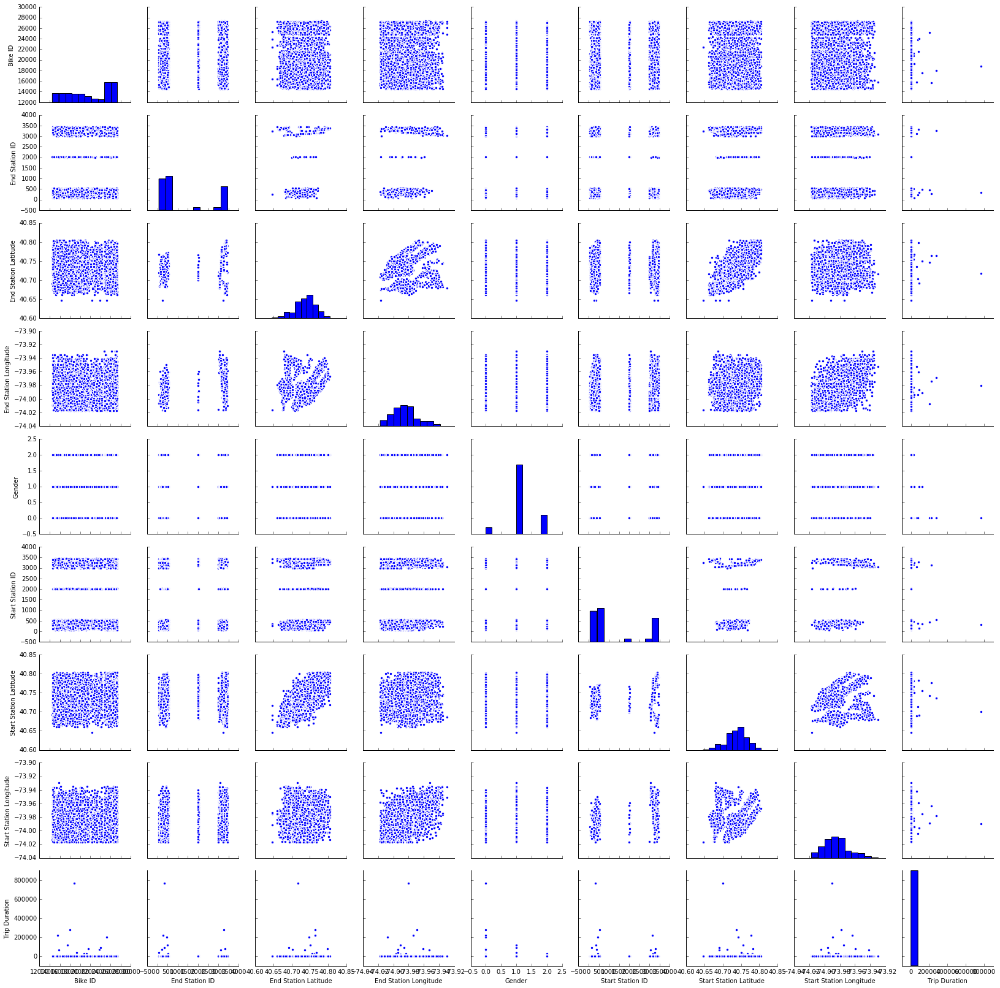

In [28]:
sns.pairplot(df_sample_pd.drop('Birth Year', axis=1)[:10000])

In [32]:
with pd.option_context('display.float_format', '{:.3f}'.format):
    display(df_sample_pd.describe())

,Bike ID,End Station ID,End Station Latitude,End Station Longitude,Gender,Start Station ID,Start Station Latitude,Start Station Longitude,Trip Duration,Birth Year
count,1224921.000,1224921.000,1224921.000,1224921.000,1224921.000,1224921.000,1224921.000,1224921.000,1224921.000,1094312.000
mean,23170.575,1316.603,40.736,-73.985,1.116,1321.702,40.736,-73.985,1013.883,1978.865
std,4972.763,1327.909,0.059,0.096,0.568,1329.464,0.028,0.017,15589.366,11.746
min,14529.000,72.000,0.000,-74.048,0.000,72.000,40.647,-74.025,61.000,1885.000
25%,18439.000,358.000,40.718,-73.997,1.000,359.000,40.718,-73.997,378.000,1971.000
50%,25168.000,483.000,40.737,-73.988,1.000,484.000,40.737,-73.988,635.000,1982.000
75%,27509.000,3132.000,40.755,-73.976,1.000,3135.000,40.755,-73.976,1103.000,1988.000
max,31977.000,3637.000,40.881,0.000,2.000,3637.000,40.881,-73.897,5780233.000,2001.000


## 4.2 remove outlier
According to the result of visualization, we can clean data:
* 0 <'Trip Duration' < 3600 
* 38 < 'End Station Latitude' < 42
* -76 < 'End Station Longitude' < -70 
* 1900 < 'Birth Year' < 2019
* 38 < 'Start Station Latitude' < 42
* -76 < 'Start Station Longitude' < -70 

In [9]:
df_proc = df.where((df['Trip Duration'] < 3600) & (df['Trip Duration'] > 0) &
                   (df['End Station Latitude'] > 38) & (df['End Station Latitude'] < 42) &
                   (df['End Station Longitude'] < -70) & (df['End Station Longitude'] > -76) & 
                   (df['Birth Year'] > 1900) & (df['Birth Year'] < 2019) &
                   (df['Start Station Latitude'] > 38) & (df['Start Station Latitude'] < 42) &
                   (df['Start Station Longitude'] < -70) & (df['Start Station Longitude'] > -76) 
                  ).persist()

In [52]:
df_proc.describe().toPandas()

,summary,Bike ID,End Station ID,End Station Latitude,End Station Longitude,End Station Name,Gender,Start Station ID,Start Station Latitude,Start Station Longitude,Start Station Name,Trip Duration,User Type,Birth Year
0,count,10886187,10886187,10886187,10886187,10886187,10886187,10886187,10886187,10886187,10886187,10886187,10886187,10886187
1,mean,23258.36919152684,1288.9554680624171,40.73588981388625,-73.9852878405701,None,1.249185137091619,1297.3802256014892,40.73618177116991,-73.98512667177478,None,751.1715078015837,None,1978.8873209692247
2,stddev,4955.764186484734,1318.735881298567,0.02725369823017809,0.016856141118533997,None,0.44173521323368103,1321.243102023168,0.02741436648270856,0.016802637713304047,None,542.5701039277264,None,11.676500456584774
3,min,14529,72,40.64653836709648,-74.0557013,1 Ave & E 110 St,0,72,40.64653836709648,-74.02535319328308,1 Ave & E 110 St,61,,1901
4,max,31979,3637,40.88092055523877,-73.89660179615021,York St & Jay St,2,3637,40.88092055523877,-73.89660179615021,York St & Jay St,3599,Subscriber,2001


## 4.3 further exploration

sample 10% data for visualization

In [ ]:
df_proc_sample_pd = df_proc.sample(False, 0.1, 42).toPandas()

In [20]:
df_proc_sample_pd.head()

,Bike ID,End Station ID,End Station Latitude,End Station Longitude,End Station Name,Gender,Start Station ID,Start Station Latitude,Start Station Longitude,Start Station Name,Trip Duration,User Type,_id,Start Time,Stop Time,Birth Year
0,16050,3163,40.773407,-73.977825,Central Park West & W 68 St,1,3163,40.773407,-73.977825,Central Park West & W 68 St,666,Subscriber,"(5a5fd4be0fd011b308f31533,)",2017-01-01 00:01:51,2017-01-01 00:12:57,2000
1,26501,3428,40.740983,-74.001702,8 Ave & W 16 St,1,515,40.760094,-73.994618,W 43 St & 10 Ave,901,Subscriber,"(5a5fd4be0fd011b308f31537,)",2017-01-01 00:09:18,2017-01-01 00:24:20,1964
2,20845,3163,40.773407,-73.977825,Central Park West & W 68 St,1,3172,40.778567,-73.977550,W 74 St & Columbus Ave,1246,Subscriber,"(5a5fd4be0fd011b308f31538,)",2017-01-01 00:09:19,2017-01-01 00:30:06,1977
3,26577,229,40.727434,-73.993790,Great Jones St,1,128,40.727103,-74.002971,MacDougal St & Prince St,207,Subscriber,"(5a5fd4be0fd011b308f31541,)",2017-01-01 00:10:53,2017-01-01 00:14:20,1991
4,21100,3357,40.800836,-73.966449,W 106 St & Amsterdam Ave,1,3169,40.787209,-73.981281,Riverside Dr & W 82 St,590,Subscriber,"(5a5fd4be0fd011b308f3155f,)",2017-01-01 00:17:36,2017-01-01 00:27:27,1979


In [10]:
with pd.option_context('display.float_format', '{:.3f}'.format):
    display(df_proc_sample_pd.describe())

,Bike ID,End Station ID,End Station Latitude,End Station Longitude,Gender,Start Station ID,Start Station Latitude,Start Station Longitude,Trip Duration,Birth Year
count,1089096.000,1089096.000,1089096.000,1089096.000,1089096.000,1089096.000,1089096.000,1089096.000,1089096.000,1089096.000
mean,23257.535,1289.511,40.736,-73.985,1.249,1295.709,40.736,-73.985,750.828,1978.891
std,4953.637,1318.813,0.027,0.017,0.442,1320.746,0.027,0.017,542.314,11.671
min,14529.000,72.000,40.647,-74.056,0.000,72.000,40.647,-74.025,61.000,1901.000
25%,18534.000,358.000,40.719,-73.997,1.000,358.000,40.719,-73.997,360.000,1971.000
50%,25242.000,481.000,40.737,-73.988,1.000,482.000,40.737,-73.988,587.000,1982.000
75%,27529.000,3118.000,40.755,-73.977,2.000,3122.000,40.755,-73.976,988.000,1988.000
max,31979.000,3637.000,40.814,-73.914,2.000,3637.000,40.814,-73.921,3599.000,2001.000


Histogram of trip duration:

In [22]:
df_proc_sample_pd['Trip Duration'].iplot(kind='hist', title='Histogram of Trip Duration')

whole data version:

In [10]:
df_td_pd = df_proc.select('Trip Duration').toPandas()

In [ ]:
df_td_pd.iplot(kind='hist', title='Histogram of Trip Duration')

- mode is 350 seconds (5 minites)
- most people's trip are within the range from 0 to 15 minutes

## 4.2 The most popular station

In [49]:
station_pop = df_proc.groupby('Start Station Name').count().sort('count', ascending=False).limit(20)
station_pop_pd = station_pop.toPandas()

In [72]:
station_pop_pd.set_index('Start Station Name').iplot(kind='bar', title='Trip Volume', xTitle='station')

In [28]:
start_loc = df_proc.select(['Start Station Name', 'Start Station Latitude', 'Start Station Longitude']).distinct()
end_loc = df_proc.select(['End Station Name', 'End Station Latitude', 'End Station Longitude']).distinct()

In [44]:
start_loc.count(), end_loc.count()

(725, 747)

In [55]:
station_pop_loc_pd = station_pop.join(start_loc, 'Start Station Name').toPandas()
station_pop_loc_pd

,Start Station Name,count,Start Station Latitude,Start Station Longitude
0,E 17 St & Broadway,78125,40.737050,-73.990093
1,Cooper Square & E 7 St,54089,40.729236,-73.990868
2,W 18 St & 6 Ave,53393,40.739713,-73.994564
3,Carmine St & 6 Ave,57100,40.730386,-74.002150
4,W 21 St & 6 Ave,75836,40.741740,-73.994156
5,Greenwich Ave & 8 Ave,54308,40.739017,-74.002638
6,West St & Chambers St,68014,40.717548,-74.013221
7,University Pl & E 14 St,53930,40.734927,-73.992005
8,8 Ave & W 33 St,66521,40.751551,-73.993934
9,W 38 St & 8 Ave,59595,40.754666,-73.991382


In [71]:
m = folium.Map(
        location=[40.74, -74], #lat, longitude
        zoom_start=12
    )

for _, r in station_pop_loc_pd.iterrows():
    folium.Circle(
        radius=r['count']/250,
        location=[r['Start Station Latitude'], r['Start Station Longitude']],
        color='crimson',
        fill=True,
    ).add_to(m)

m

## 4.4 Cluster of station

Cluster all stations based on its lat and longt

In [ ]:
m = folium.Map(
        location=[40.74, -74], #lat, longitude
        zoom_start=12
    )

for _, r in station_pop_loc_pd.iterrows():
    folium.Circle(
        radius=r['count']/250,
        location=[r['Start Station Latitude'], r['Start Station Longitude']],
        color='crimson',
        fill=True,
    ).add_to(m)

m

## 4.3 Trip Volume

In [53]:
station_pop_pd[:5]

,Start Station Name,count
0,Pershing Square North,113178
1,E 17 St & Broadway,78125
2,Broadway & E 22 St,76285
3,W 21 St & 6 Ave,75836
4,West St & Chambers St,68014


In [52]:
station_pop_name = station_pop_pd['Start Station Name'].tolist()
station_pop_name[:5]

[u'Pershing Square North',
 u'E 17 St & Broadway',
 u'Broadway & E 22 St',
 u'W 21 St & 6 Ave',
 u'West St & Chambers St']

In [14]:
def transform_df(df):
    df['counts'] = 1
    df['Start Date'] = df['Start Time'].apply(pd.to_datetime)
    return df.set_index('Start Date').resample('D').sum()

In [15]:
pop_stations =  []
pop_stations.append(transform_df(df_proc.where(df_proc['Start Station Name']=='Pershing Square North').\
                                         select('Start Time').\
                                         toPandas()))

In [16]:
pop_stations.append(transform_df(df_proc.where(df_proc['Start Station Name']=='E 17 St & Broadway').\
                                        select('Start Time').\
                                        toPandas()))

In [17]:
pop_stations_plot = [Scatter(x=s.index, y=s.counts, name=n) for s,n in zip(pop_stations, station_pop_name[:2])]

In [56]:
layout = Layout(title='Trip volume')
fig = Figure(data=pop_stations_plot, layout=layout)

In [57]:
iplot(fig)

- We can see the break between workdays and weekend
- Two station have similar pattern
- Both station show an increasing trend

## 4.3 The most popular routes

In [ ]:
# select top 20 most popular routes
routes = df_proc.groupby(['Start Station Name', 'End Station Name']).\
                 count().\
                 sort('count', ascending=False).\
                 limit(20).\
                 persist()

In [39]:
routes.toPandas()

,Start Station Name,End Station Name,count
0,E 7 St & Avenue A,Cooper Square & E 7 St,5898
1,W 21 St & 6 Ave,9 Ave & W 22 St,3557
2,Greenwich Ave & Charles St,Greenwich Ave & Charles St,3419
3,Pershing Square North,Broadway & W 32 St,3293
4,Pershing Square North,W 33 St & 7 Ave,3207
5,Pershing Square North,E 24 St & Park Ave S,3201
6,Cooper Square & E 7 St,E 7 St & Avenue A,3147
7,Richardson St & N Henry St,Graham Ave & Conselyea St,3078
8,N 6 St & Bedford Ave,Wythe Ave & Metropolitan Ave,3035
9,S 4 St & Wythe Ave,N 6 St & Bedford Ave,2783


In [ ]:
routes_loc = routes.join(start_loc, 'Start Station Name').join(end_loc, 'End Station Name')

In [40]:
routes_loc_pd = routes_loc.toPandas()
routes_loc_pd

,End Station Name,Start Station Name,count,Start Station Latitude,Start Station Longitude,End Station Latitude,End Station Longitude
0,Cooper Square & E 7 St,E 7 St & Avenue A,5898,40.726218,-73.983799,40.729236,-73.990868
1,9 Ave & W 22 St,W 21 St & 6 Ave,3557,40.741740,-73.994156,40.745497,-74.001971
2,Graham Ave & Conselyea St,Richardson St & N Henry St,3078,40.719079,-73.942237,40.715143,-73.944507
3,Pershing Square North,6 Ave & W 33 St,2604,40.749013,-73.988484,40.751873,-73.977706
4,Pershing Square North,E 30 St & Park Ave S,2667,40.744449,-73.983035,40.751873,-73.977706
5,Wythe Ave & Metropolitan Ave,N 6 St & Bedford Ave,3035,40.717452,-73.958509,40.716887,-73.963198
6,Broadway & W 32 St,Pershing Square North,3293,40.751873,-73.977706,40.748549,-73.988084
7,N 6 St & Bedford Ave,Wythe Ave & Metropolitan Ave,2732,40.716887,-73.963198,40.717452,-73.958509
8,N 6 St & Bedford Ave,S 4 St & Wythe Ave,2783,40.712859,-73.965903,40.717452,-73.958509
9,S 4 St & Wythe Ave,N 6 St & Bedford Ave,2775,40.717452,-73.958509,40.712859,-73.965903
